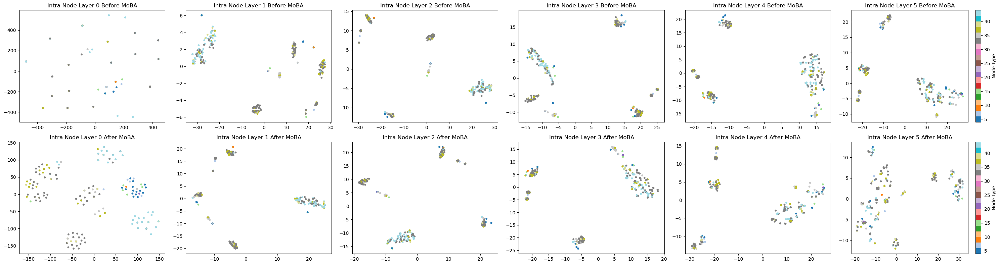

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

feature_dir = 'node_feature_dump'


layer_ids = [0, 1, 2, 3, 4, 5]  

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    
    feat_before = np.load(f'{feature_dir}/intra_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]

    
    tsne = TSNE(n_components=2, random_state=42)
    feat_before_2d = tsne.fit_transform(feat_before)
    feat_after_2d = tsne.fit_transform(feat_after)

    
    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    
    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Intra Node Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Intra Node Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()


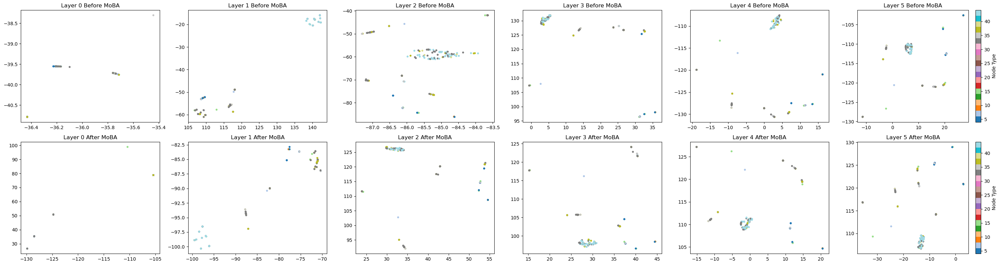

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

feature_dir = 'node_feature_dump'


layer_ids = [0, 1, 2, 3, 4, 5]  


node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):

    feat_before = np.load(f'{feature_dir}/intra_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_edge_after_moba_{layer}.npy')
    if feat_before.ndim == 4:
        feat_before = feat_before[0]
    if feat_after.ndim == 4:
        feat_after = feat_after[0]
    
    if feat_before.ndim == 3:
        N1, N2, D = feat_before.shape
        feat_before = feat_before.reshape(-1, D)
        feat_after = feat_after.reshape(-1, D)
    elif feat_before.ndim == 2:
        pass  

    n_samples = feat_before.shape[0]
    perplexity = min(30, max(2, n_samples // 3))
    tsne = TSNE(n_components=2, random_state=42, perplexity=perplexity)
    feat_before_2d = tsne.fit_transform(feat_before)
    feat_after_2d = tsne.fit_transform(feat_after)

    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')


    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()

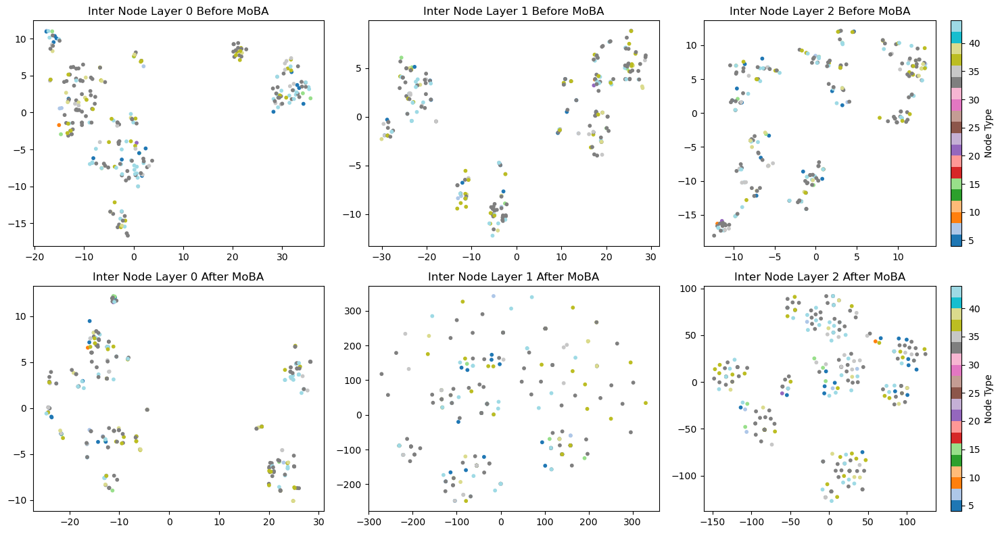

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE


feature_dir = 'node_feature_dump'

layer_ids = [0, 1, 2]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    
    feat_before = np.load(f'{feature_dir}/inter_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]

    tsne = TSNE(n_components=2, random_state=42)
    feat_before_2d = tsne.fit_transform(feat_before)
    feat_after_2d = tsne.fit_transform(feat_after)

    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Inter Node Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Inter Node Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()

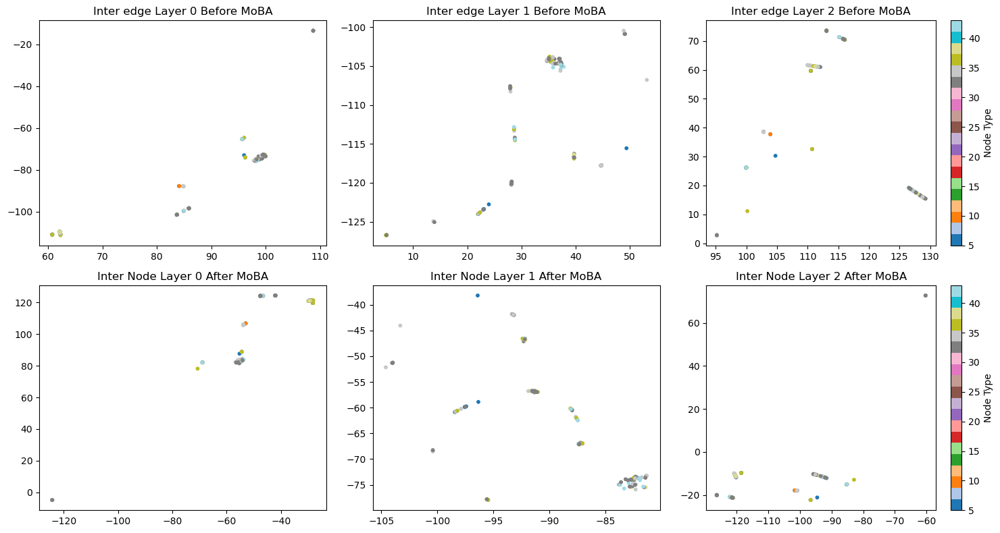

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

feature_dir = 'node_feature_dump'

layer_ids = [0, 1, 2]  

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):

    feat_before = np.load(f'{feature_dir}/inter_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_edge_after_moba_{layer}.npy')
    if feat_before.ndim == 4:
        feat_before = feat_before[0]
    if feat_after.ndim == 4:
        feat_after = feat_after[0]

    if feat_before.ndim == 3:
        N1, N2, D = feat_before.shape
        feat_before = feat_before.reshape(-1, D)
        feat_after = feat_after.reshape(-1, D)
    elif feat_before.ndim == 2:
        pass  

 
    tsne = TSNE(n_components=2, random_state=42)
    feat_before_2d = tsne.fit_transform(feat_before)
    feat_after_2d = tsne.fit_transform(feat_after)

    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Inter edge Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Inter Node Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()

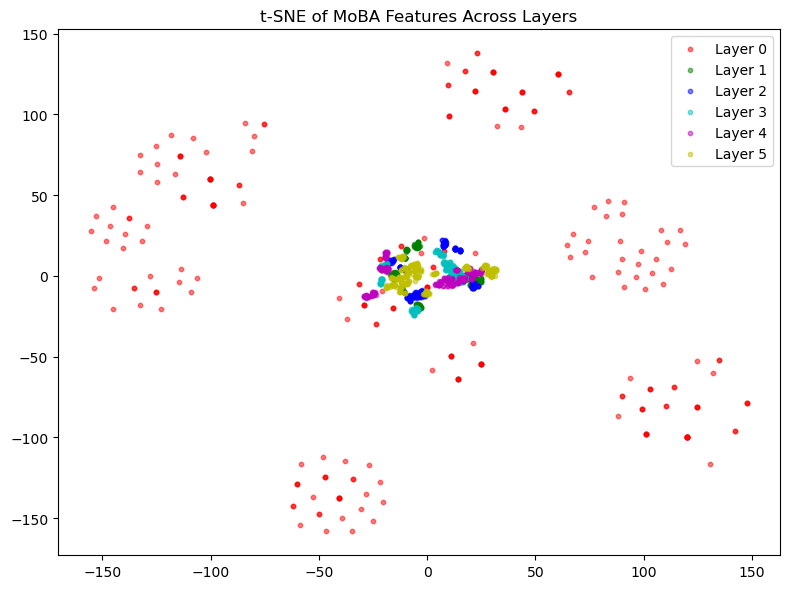

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2, 3, 4, 5] 
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']  

plt.figure(figsize=(8, 6))

for idx, layer in enumerate(layer_ids):
    feat = np.load(f'{feature_dir}/moba_intra_node_after_moba_{layer}.npy')
    if feat.ndim == 3:
        feat = feat[0]
    tsne = TSNE(n_components=2, random_state=42)
    feat_2d = tsne.fit_transform(feat)
    min_len = feat_2d.shape[0]
    plt.scatter(feat_2d[:min_len, 0], feat_2d[:min_len, 1], 
                c=colors[idx % len(colors)], s=10, alpha=0.5, label=f'Layer {layer}')

plt.title('t-SNE of MoBA Features Across Layers')
plt.legend()
plt.tight_layout()
plt.show()

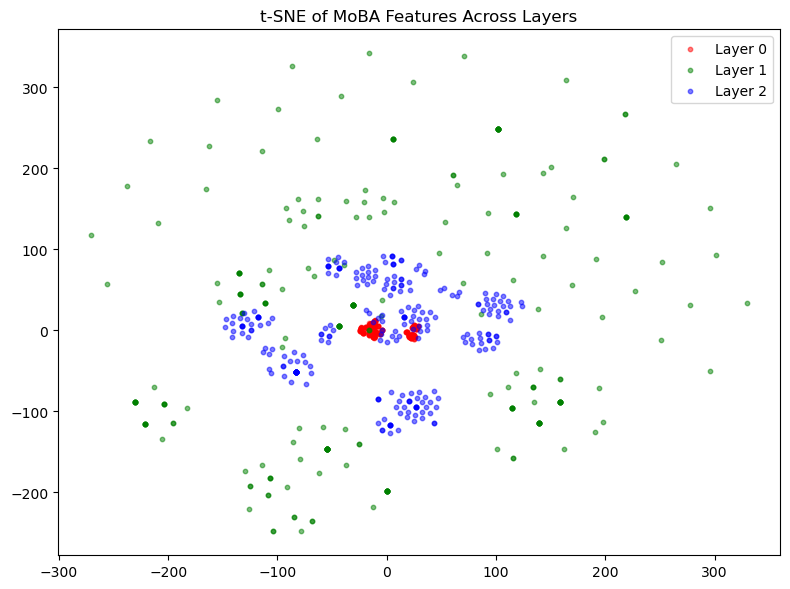

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2]  
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k'] 

plt.figure(figsize=(8, 6))

for idx, layer in enumerate(layer_ids):
    feat = np.load(f'{feature_dir}/moba_inter_node_after_moba_{layer}.npy')
    if feat.ndim == 3:
        feat = feat[0]
    tsne = TSNE(n_components=2, random_state=42)
    feat_2d = tsne.fit_transform(feat)
    min_len = feat_2d.shape[0]
    plt.scatter(feat_2d[:min_len, 0], feat_2d[:min_len, 1], 
                c=colors[idx % len(colors)], s=10, alpha=0.5, label=f'Layer {layer}')

plt.title('t-SNE of MoBA Features Across Layers')
plt.legend()
plt.tight_layout()
plt.show()

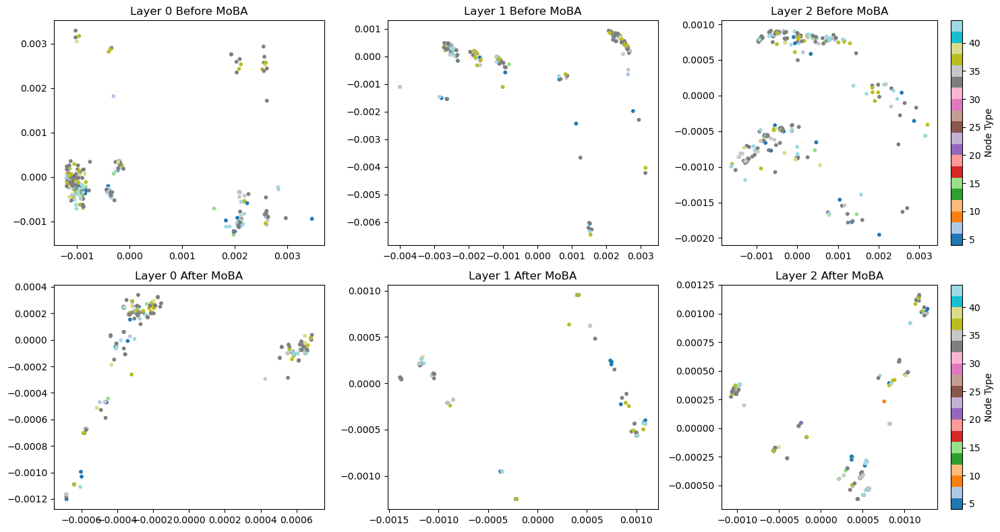

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

feature_dir = 'node_feature_dump'

layer_ids = [0, 1, 2]  

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):

    feat_before = np.load(f'{feature_dir}/inter_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]


    pca = PCA(n_components=2)
    feat_before_2d = pca.fit_transform(feat_before)
    feat_after_2d = pca.fit_transform(feat_after)


    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')


    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

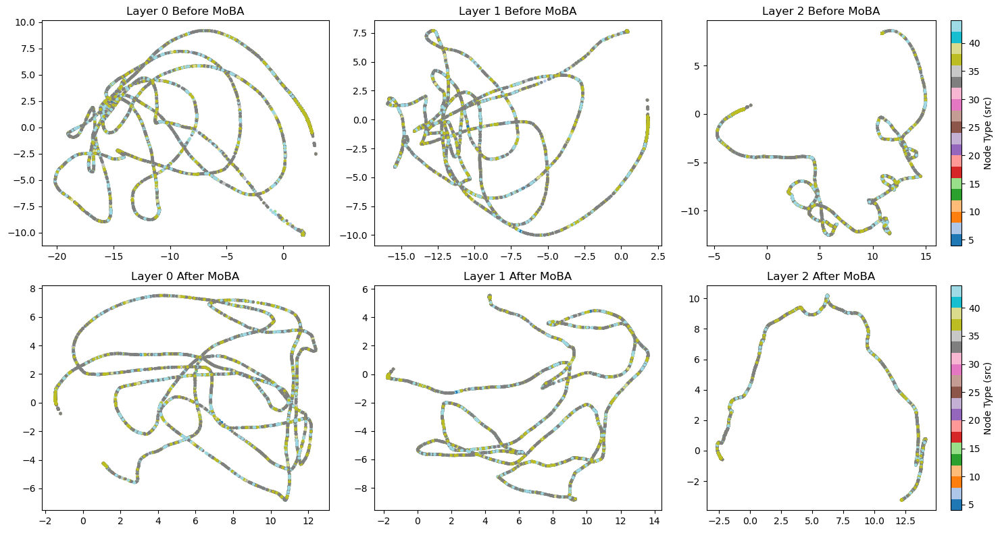

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


feature_dir = 'node_feature_dump'

layer_ids = [0, 1, 2]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):

    feat_before = np.load(f'{feature_dir}/inter_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_edge_after_moba_{layer}.npy')
    if feat_before.ndim == 4:
        feat_before = feat_before[0]  
    if feat_after.ndim == 4:
        feat_after = feat_after[0]

    # [N, N, D] -> [N*N, D]
    N1, N2, D = feat_before.shape
    feat_before_2d = feat_before.reshape(-1, D)
    feat_after_2d = feat_after.reshape(-1, D)

    pca = PCA(n_components=2)
    feat_before_pca = pca.fit_transform(feat_before_2d)
    feat_after_pca = pca.fit_transform(feat_after_2d)

    node_type_repeat = np.repeat(node_type[:N1], N2)

    min_len_before = min(feat_before_pca.shape[0], node_type_repeat.shape[0])
    min_len_after = min(feat_after_pca.shape[0], node_type_repeat.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_pca[:min_len_before, 0],
        feat_before_pca[:min_len_before, 1],
        c=node_type_repeat[:min_len_before],
        cmap='tab20', s=5)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type (src)')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_pca[:min_len_after, 0],
        feat_after_pca[:min_len_after, 1],
        c=node_type_repeat[:min_len_after],
        cmap='tab20', s=5)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type (src)')

plt.tight_layout()

plt.show()

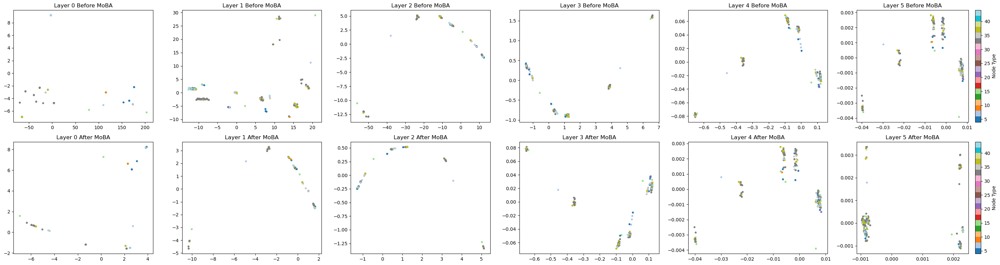

In [39]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


feature_dir = 'node_feature_dump'


layer_ids = [0, 1, 2, 3, 4, 5]  

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    
    feat_before = np.load(f'{feature_dir}/intra_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]

    
    pca = PCA(n_components=2)
    feat_before_2d = pca.fit_transform(feat_before)
    feat_after_2d = pca.fit_transform(feat_after)

  
    min_len_before = min(feat_before_2d.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_2d.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_2d[:min_len_before, 0],
        feat_before_2d[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')


    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_2d[:min_len_after, 0],
        feat_after_2d[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

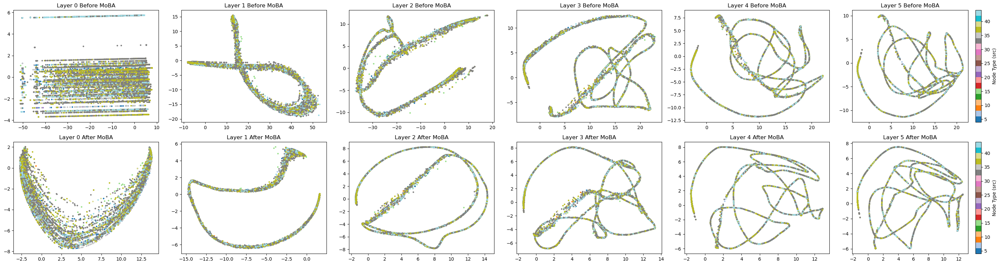

In [40]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


feature_dir = 'node_feature_dump'

layer_ids = [0, 1, 2, 3, 4, 5]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    
    feat_before = np.load(f'{feature_dir}/intra_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_edge_after_moba_{layer}.npy')
    if feat_before.ndim == 4:
        feat_before = feat_before[0]  
    if feat_after.ndim == 4:
        feat_after = feat_after[0]

    # [N, N, D] -> [N*N, D]
    N1, N2, D = feat_before.shape
    feat_before_2d = feat_before.reshape(-1, D)
    feat_after_2d = feat_after.reshape(-1, D)


    pca = PCA(n_components=2)
    feat_before_pca = pca.fit_transform(feat_before_2d)
    feat_after_pca = pca.fit_transform(feat_after_2d)

    node_type_repeat = np.repeat(node_type[:N1], N2)
  
    min_len_before = min(feat_before_pca.shape[0], node_type_repeat.shape[0])
    min_len_after = min(feat_after_pca.shape[0], node_type_repeat.shape[0])


    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_pca[:min_len_before, 0],
        feat_before_pca[:min_len_before, 1],
        c=node_type_repeat[:min_len_before],
        cmap='tab20', s=5)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type (src)')


    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_pca[:min_len_after, 0],
        feat_after_pca[:min_len_after, 1],
        c=node_type_repeat[:min_len_after],
        cmap='tab20', s=5)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type (src)')

plt.tight_layout()
plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


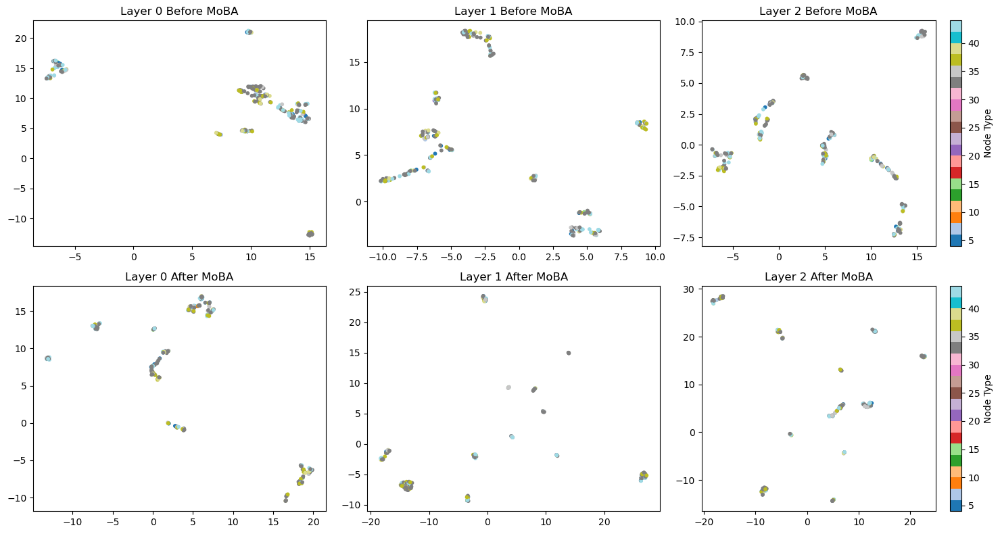

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import umap


feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/inter_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]


    reducer = umap.UMAP(n_components=2, random_state=42)
    feat_before_umap = reducer.fit_transform(feat_before)
    feat_after_umap = reducer.fit_transform(feat_after)

    min_len_before = min(feat_before_umap.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_umap.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_umap[:min_len_before, 0],
        feat_before_umap[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_umap[:min_len_after, 0],
        feat_after_umap[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


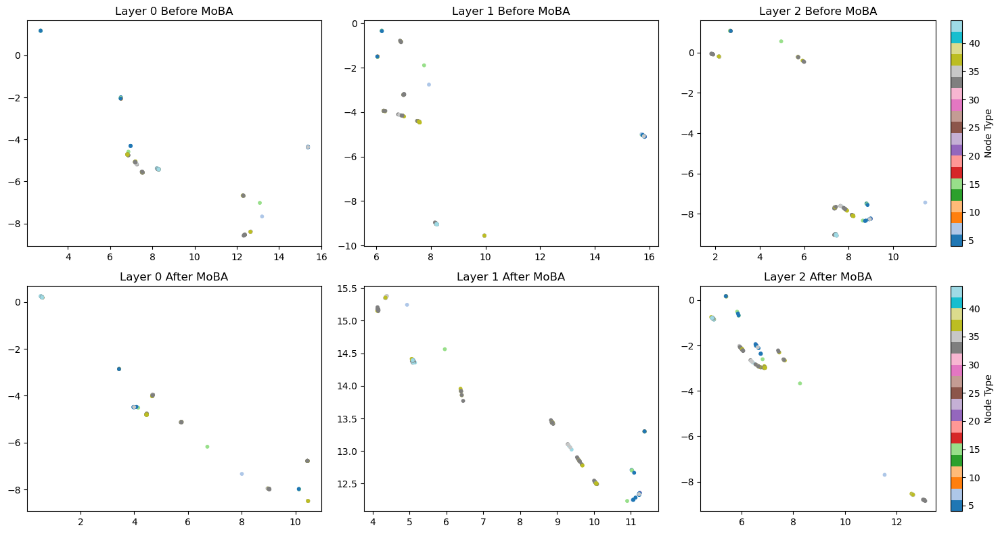

In [51]:
import numpy as np
import matplotlib.pyplot as plt
import umap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2] 

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/inter_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_edge_after_moba_{layer}.npy')
    if feat_before.ndim > 2:
        feat_before = feat_before.reshape(-1, feat_before.shape[-1])
    if feat_after.ndim > 2:
        feat_after = feat_after.reshape(-1, feat_after.shape[-1])

    reducer = umap.UMAP(n_components=2, random_state=42)
    feat_before_umap = reducer.fit_transform(feat_before)
    feat_after_umap = reducer.fit_transform(feat_after)

    min_len_before = min(feat_before_umap.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_umap.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_umap[:min_len_before, 0],
        feat_before_umap[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_umap[:min_len_after, 0],
        feat_after_umap[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_spectral_embedding.py:328: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_spectral_embedding.py:328: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.

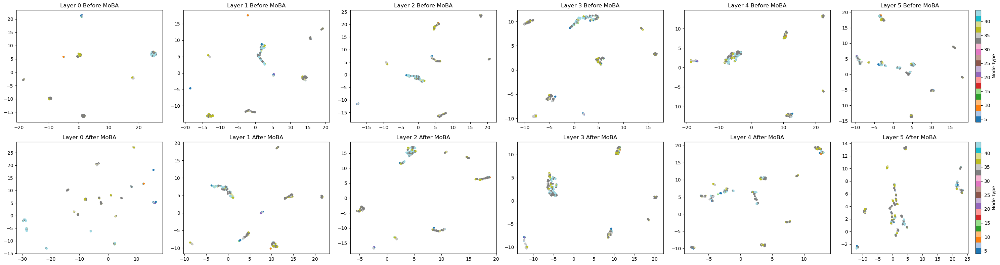

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import umap


feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2, 3, 4, 5]  

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/intra_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]


    reducer = umap.UMAP(n_components=2, random_state=42)
    feat_before_umap = reducer.fit_transform(feat_before)
    feat_after_umap = reducer.fit_transform(feat_after)

    min_len_before = min(feat_before_umap.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_umap.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_umap[:min_len_before, 0],
        feat_before_umap[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_umap[:min_len_after, 0],
        feat_after_umap[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!


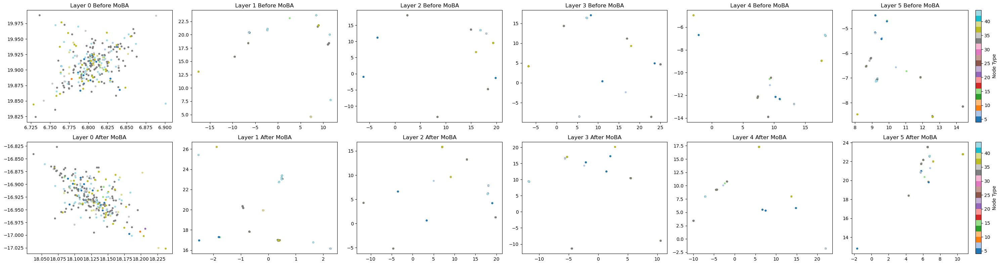

In [52]:
import numpy as np
import matplotlib.pyplot as plt
import umap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2, 3, 4, 5] 

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 2:
    node_type = node_type[0]

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/intra_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_edge_after_moba_{layer}.npy')
    if feat_before.ndim > 2:
        feat_before = feat_before.reshape(-1, feat_before.shape[-1])
    if feat_after.ndim > 2:
        feat_after = feat_after.reshape(-1, feat_after.shape[-1])

    reducer = umap.UMAP(n_components=2, random_state=42)
    feat_before_umap = reducer.fit_transform(feat_before)
    feat_after_umap = reducer.fit_transform(feat_after)

    min_len_before = min(feat_before_umap.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_umap.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_umap[:min_len_before, 0],
        feat_before_umap[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_umap[:min_len_after, 0],
        feat_after_umap[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_isomap.py:384: UserWarning: The number of connected components of the neighbors graph is 2 > 1. Completing the graph to fit Isomap might be slow. Increase the number of neighbors to avoid this issue.
  self._fit_transform(X)
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_isomap.py:384: UserWarning: The number of connected components of the neighbors graph is 4 > 1. Completing the graph to fit Isomap might be slow. Increase the number of neighbors to avoid this issue.
  self._fit_transform(X)
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: C

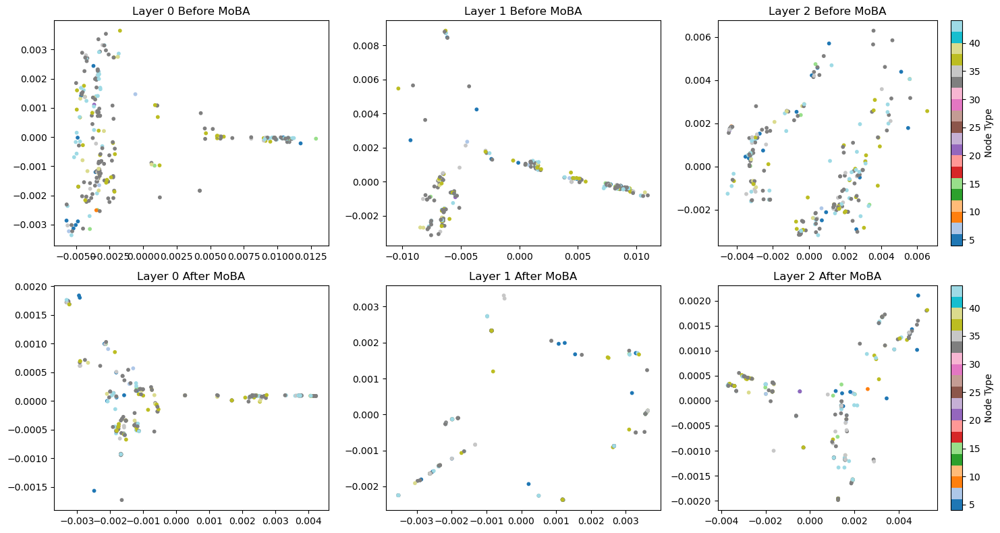

In [48]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 3:
    node_type = node_type[0]
if node_type.ndim > 1:
    node_type = node_type[:, 0]  

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/inter_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]

    isomap = Isomap(n_components=2, n_neighbors=20)
    feat_before_iso = isomap.fit_transform(feat_before)
    feat_after_iso = isomap.fit_transform(feat_after)

    min_len_before = min(feat_before_iso.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_iso.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_iso[:min_len_before, 0],
        feat_before_iso[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_iso[:min_len_after, 0],
        feat_after_iso[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_isomap.py:384: UserWarning: The number of connected components of the neighbors graph is 3 > 1. Completing the graph to fit Isomap might be slow. Increase the number of neighbors to avoid this issue.
  self._fit_transform(X)
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expen

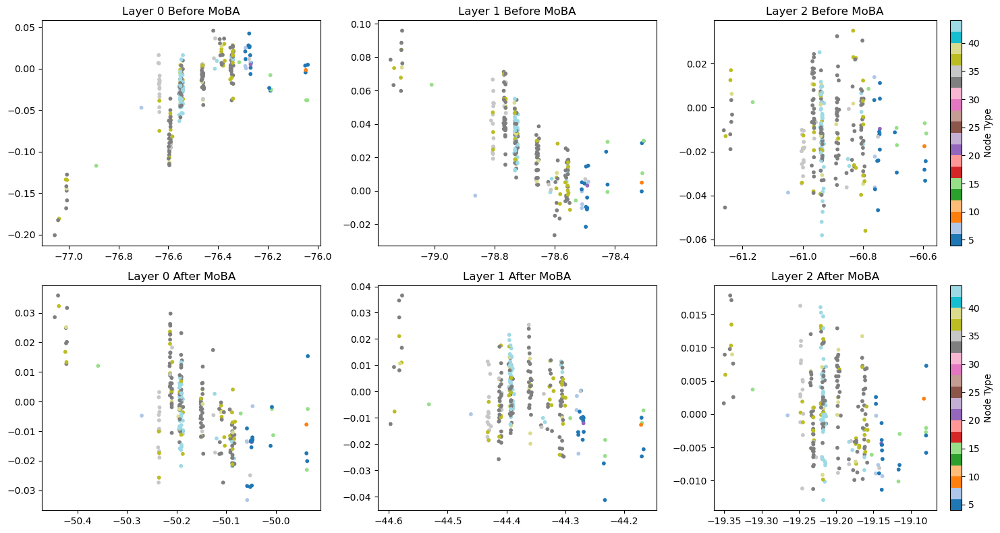

In [53]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 3:
    node_type = node_type[0]
if node_type.ndim > 1:
    node_type = node_type[:, 0]  

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/inter_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_inter_edge_after_moba_{layer}.npy')
    if feat_before.ndim > 2:
        feat_before = feat_before.reshape(-1, feat_before.shape[-1])
    if feat_after.ndim > 2:
        feat_after = feat_after.reshape(-1, feat_after.shape[-1])

    isomap = Isomap(n_components=2, n_neighbors=20)
    feat_before_iso = isomap.fit_transform(feat_before)
    feat_after_iso = isomap.fit_transform(feat_after)

    min_len_before = min(feat_before_iso.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_iso.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_iso[:min_len_before, 0],
        feat_before_iso[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_iso[:min_len_after, 0],
        feat_after_iso[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_isomap.py:384: UserWarning: The number of connected components of the neighbors graph is 4 > 1. Completing the graph to fit Isomap might be slow. Increase the number of neighbors to avoid this issue.
  self._fit_transform(X)
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expen

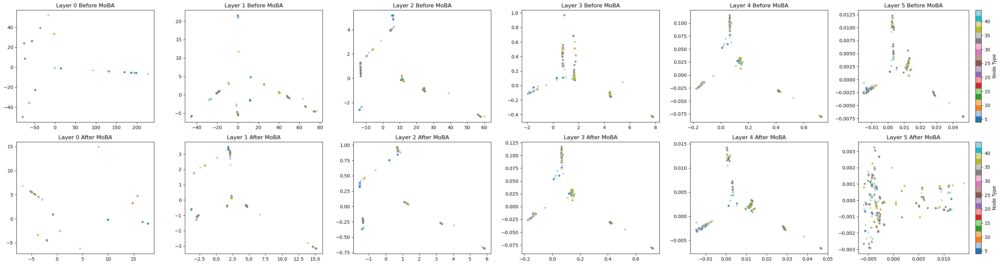

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2, 3, 4, 5]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 3:
    node_type = node_type[0]
if node_type.ndim > 1:
    node_type = node_type[:, 0]  

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/intra_node_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_node_after_moba_{layer}.npy')
    if feat_before.ndim == 3:
        feat_before = feat_before[0]
    if feat_after.ndim == 3:
        feat_after = feat_after[0]

    isomap = Isomap(n_components=2, n_neighbors=20)
    feat_before_iso = isomap.fit_transform(feat_before)
    feat_after_iso = isomap.fit_transform(feat_after)

    min_len_before = min(feat_before_iso.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_iso.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_iso[:min_len_before, 0],
        feat_before_iso[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_iso[:min_len_after, 0],
        feat_after_iso[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()
plt.show()

/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/sklearn/manifold/_isomap.py:384: UserWarning: The number of connected components of the neighbors graph is 13 > 1. Completing the graph to fit Isomap might be slow. Increase the number of neighbors to avoid this issue.
  self._fit_transform(X)
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil and dok are more efficient.
  self._set_intXint(row, col, x.flat[0])
/home/deng/miniconda3/envs/interformer/lib/python3.12/site-packages/scipy/sparse/_index.py:108: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expe

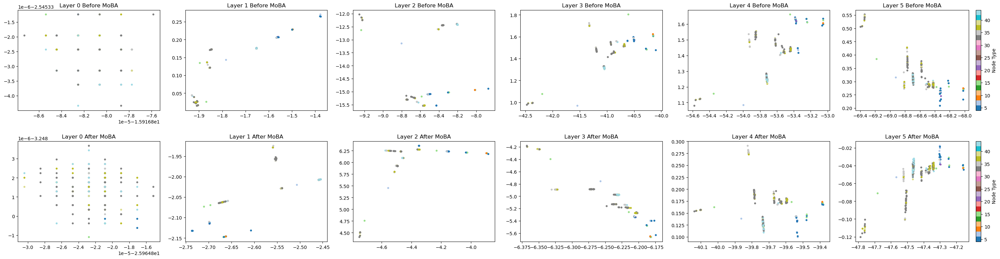

In [54]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import Isomap

feature_dir = 'node_feature_dump'
layer_ids = [0, 1, 2, 3, 4, 5]

node_type = np.load(f'{feature_dir}/node_type.npy')
if node_type.ndim == 3:
    node_type = node_type[0]
if node_type.ndim > 1:
    node_type = node_type[:, 0] 

plt.figure(figsize=(5 * len(layer_ids), 8))

for idx, layer in enumerate(layer_ids):
    feat_before = np.load(f'{feature_dir}/intra_edge_before_moba_{layer}.npy')
    feat_after = np.load(f'{feature_dir}/moba_intra_edge_after_moba_{layer}.npy')
    if feat_before.ndim > 2:
        feat_before = feat_before.reshape(-1, feat_before.shape[-1])
    if feat_after.ndim > 2:
        feat_after = feat_after.reshape(-1, feat_after.shape[-1])

 
    isomap = Isomap(n_components=2, n_neighbors=20)
    feat_before_iso = isomap.fit_transform(feat_before)
    feat_after_iso = isomap.fit_transform(feat_after)

    min_len_before = min(feat_before_iso.shape[0], node_type.shape[0])
    min_len_after = min(feat_after_iso.shape[0], node_type.shape[0])

    plt.subplot(2, len(layer_ids), idx + 1)
    scatter1 = plt.scatter(
        feat_before_iso[:min_len_before, 0],
        feat_before_iso[:min_len_before, 1],
        c=node_type[:min_len_before],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} Before MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter1, label='Node Type')

    plt.subplot(2, len(layer_ids), len(layer_ids) + idx + 1)
    scatter2 = plt.scatter(
        feat_after_iso[:min_len_after, 0],
        feat_after_iso[:min_len_after, 1],
        c=node_type[:min_len_after],
        cmap='tab20', s=10)
    plt.title(f'Layer {layer} After MoBA')
    if idx == len(layer_ids) - 1:
        plt.colorbar(scatter2, label='Node Type')

plt.tight_layout()

plt.show()